<a href="https://colab.research.google.com/github/ClaudioCazzetta/VISIONE-E-PERCEZIONE/blob/Claudio/CupObjectronVideo.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!pip install opencv-python mediapipe

     |████████████████████████████████| 32.7 MB 282 kB/s 


In [2]:
!git clone "https://github.com/ClaudioCazzetta/VISIONE-E-PERCEZIONE.git"

Cloning into 'VISIONE-E-PERCEZIONE'...
remote: Enumerating objects: 29, done.
remote: Counting objects: 100% (29/29), done.
remote: Compressing objects: 100% (27/27), done.
remote: Total 29 (delta 7), reused 19 (delta 1), pack-reused 0
Unpacking objects: 100% (29/29), done.


In [3]:
import cv2
import mediapipe as mp

In [4]:
mp_drawing = mp.solutions.drawing_utils
mp_objectron = mp.solutions.objectron

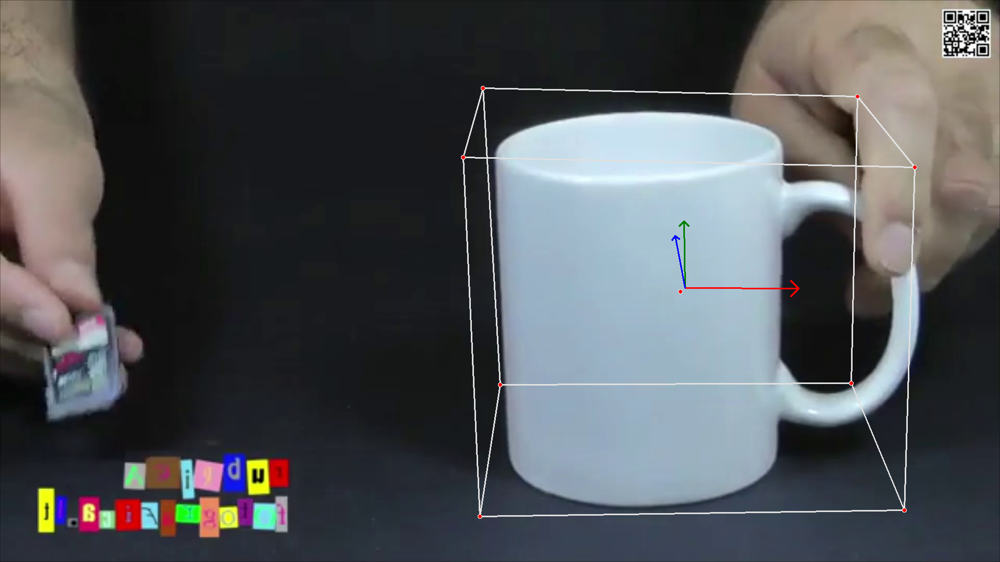

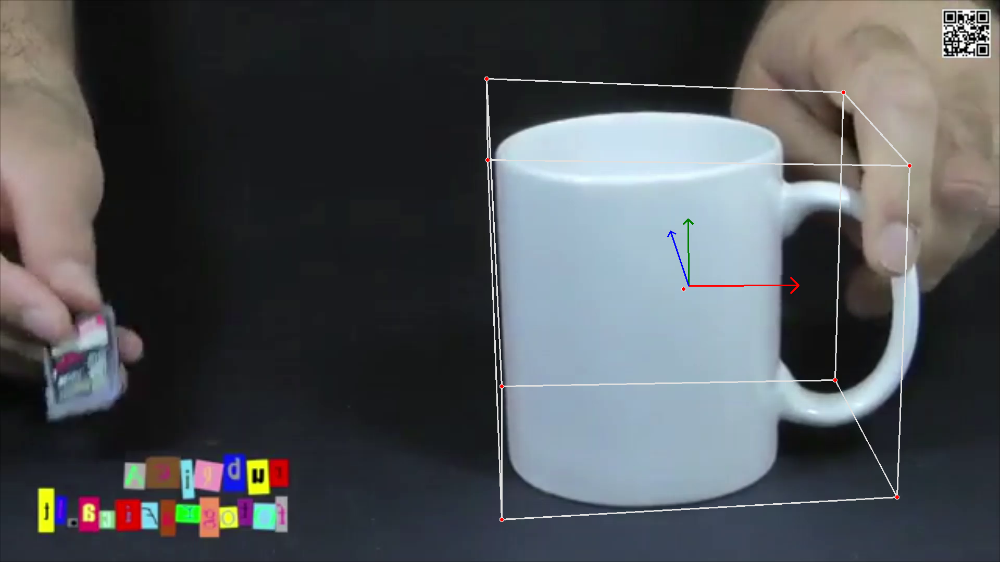

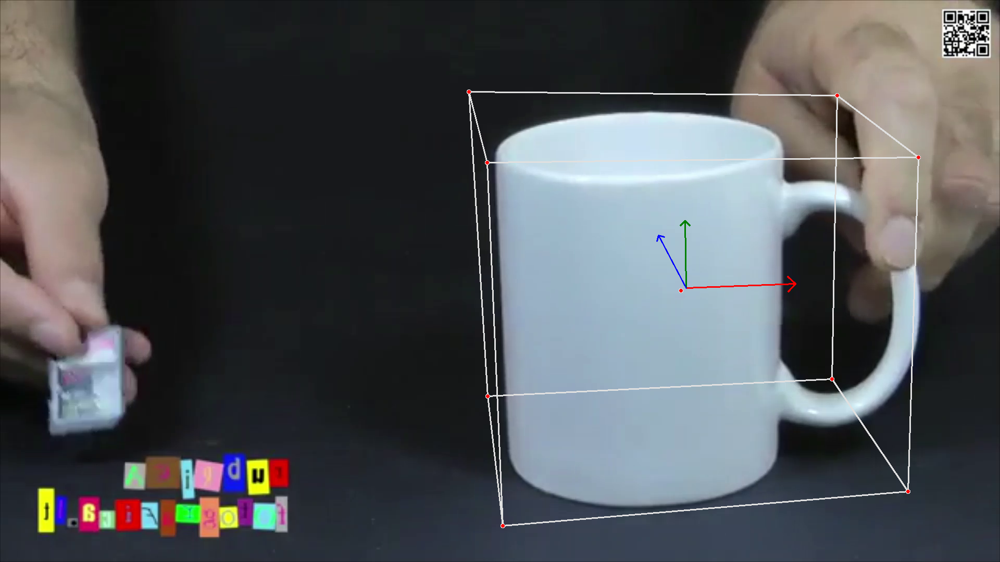

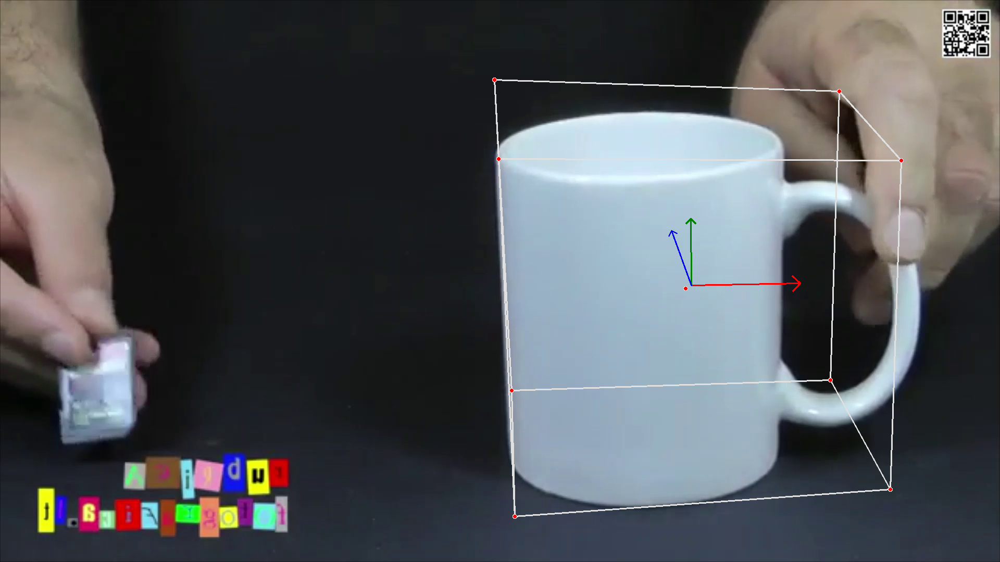

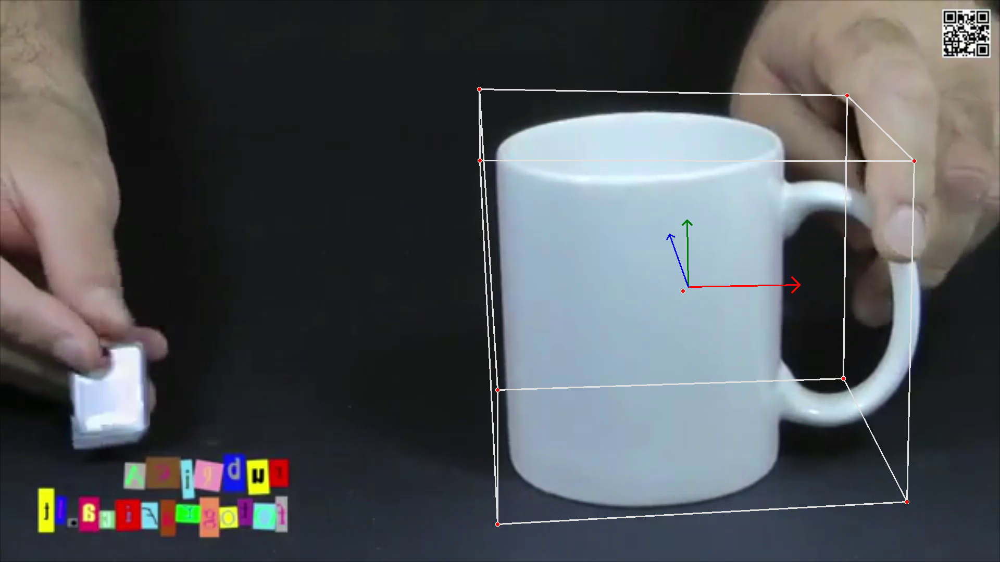

...

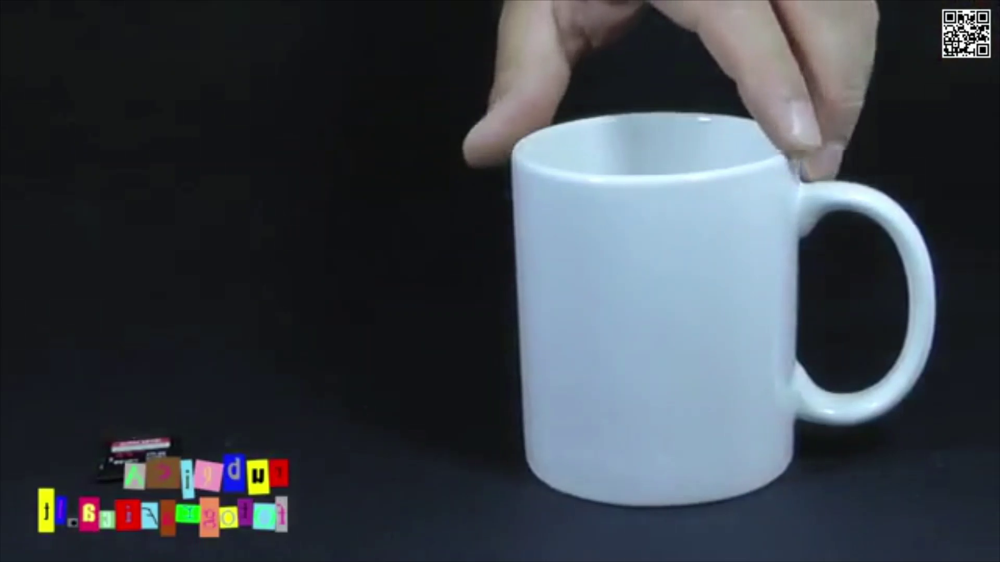

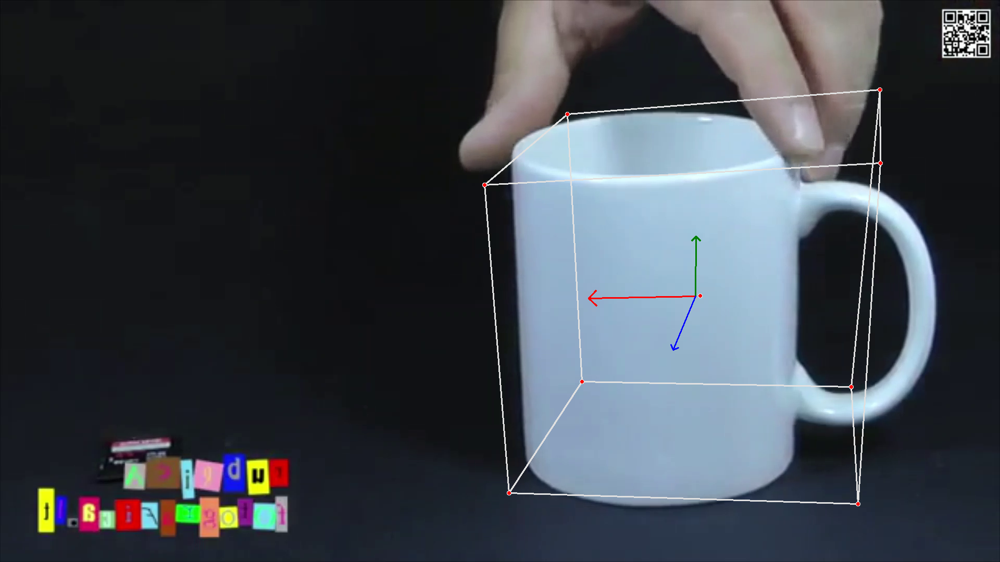

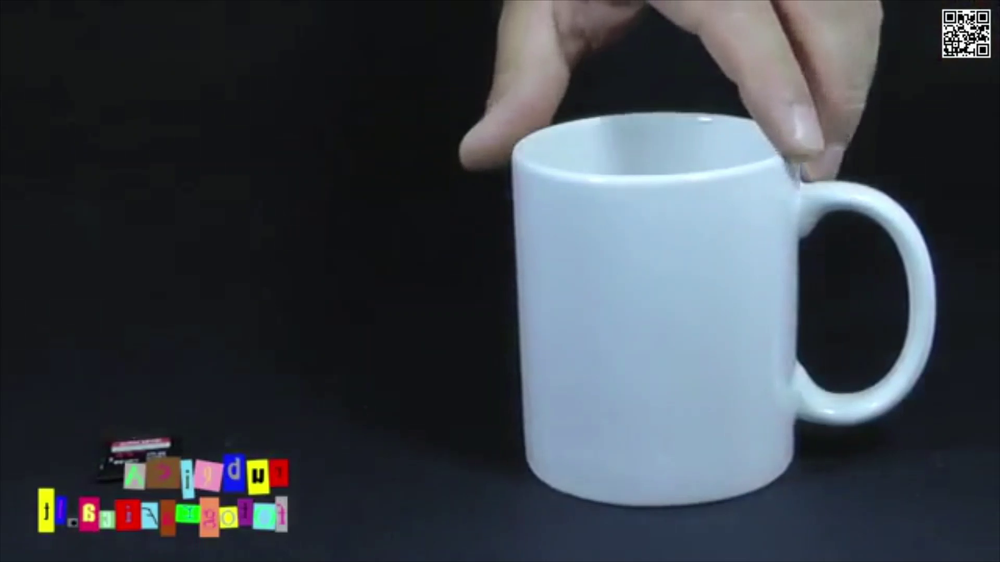

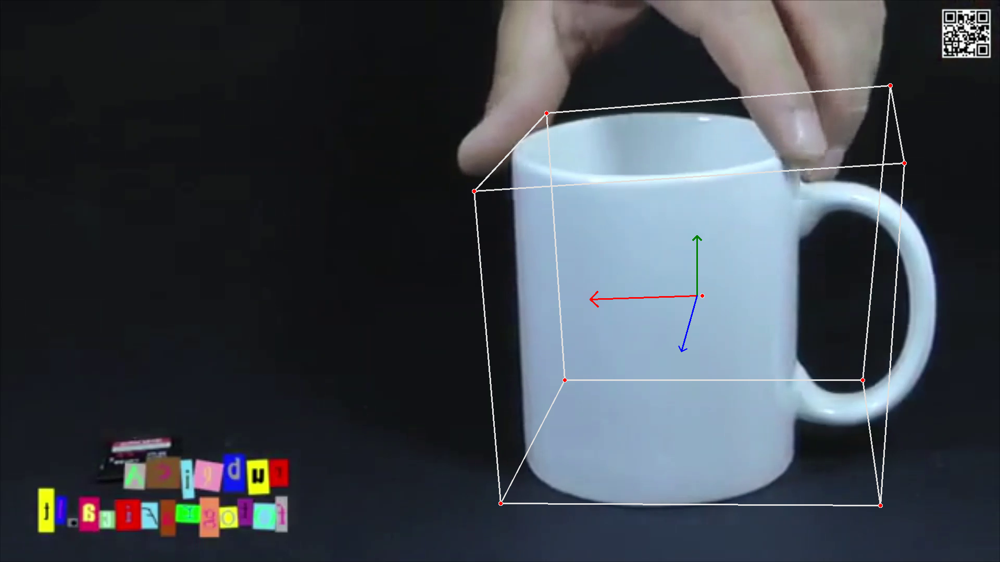

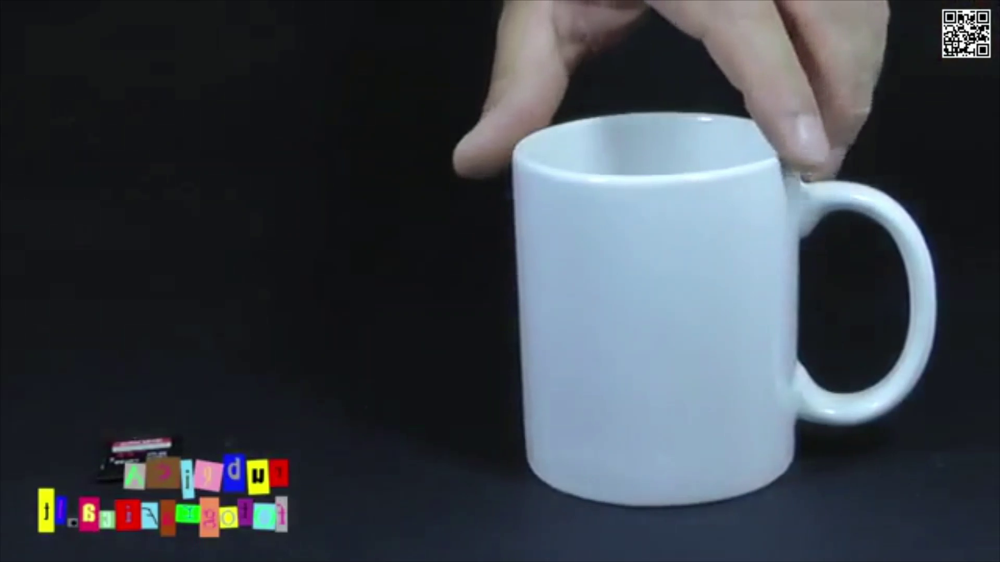

In [ ]:
# For video input:

from google.colab.patches import cv2_imshow

video = "/content/VISIONE-E-PERCEZIONE/media/video1.mp4";
cap = cv2.VideoCapture(video)

with mp_objectron.Objectron(static_image_mode=False,
                            max_num_objects=5,
                            min_detection_confidence=0.5,
                            min_tracking_confidence=0.99,
                            model_name='Cup') as objectron:
  while cap.isOpened():
    success, image = cap.read()
    if not success:
      print("Ignoring empty camera frame.")
      # If loading a video, use 'break' instead of 'continue'.
      continue

    # To improve performance, optionally mark the image as not writeable to
    # pass by reference.
    image.flags.writeable = False
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    results = objectron.process(image)

    # Draw the box landmarks on the image.
    image.flags.writeable = True
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)
    if results.detected_objects:
        for detected_object in results.detected_objects:
            mp_drawing.draw_landmarks(
              image, detected_object.landmarks_2d, mp_objectron.BOX_CONNECTIONS)
            mp_drawing.draw_axis(image, detected_object.rotation,
                                 detected_object.translation)
    # Flip the image horizontally for a selfie-view display.
    cv2_imshow( cv2.flip(image, 1))
    if cv2.waitKey(5) & 0xFF == 27:
      break

    #if cv2.waitKey(1) == ord('q'):
     #   cap.release()

cap.release()